In [288]:
library(fpp3)
library(stringr)
library(plotly)
library(mclust)
options(repr.plot.width=20, repr.plot.height=10)

In [114]:
# submission sample
df_sample_submission <- read.csv("sample_submission_afcs2022.csv")
head(df_sample_submission)

,id,F1,F2,F3,F4,F5,F6,F7,F8,F9,⋯,F19,F20,F21,F22,F23,F24,F25,F26,F27,F28
,<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,FOODS_3_001_TX_3_validation,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
2,FOODS_3_002_TX_3_validation,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
3,FOODS_3_003_TX_3_validation,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
4,FOODS_3_004_TX_3_validation,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
5,FOODS_3_005_TX_3_validation,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
6,FOODS_3_006_TX_3_validation,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0


# EDA

## Prepare data

In [250]:
df_sales_ori <- read.csv("sales_train_validation_afcs2022.csv")
df_sales_ori = df_sales_ori %>%
    pivot_longer(!id, names_to = "day", values_to = "sales")
df_sales = df_sales_ori %>%
    # extract day number d_1 -> 1
    mutate(day = str_split(day, "_", simplify = TRUE)[ , 2]) %>%
    # transform day number to date
    mutate(date = as_date("2011-01-29") + strtoi(day)-1) %>%
    select(-day)
df_sales = df_sales %>% 
    mutate(year = year(date)) %>% 
    mutate(month = yearmonth(date)) %>% 
    mutate(week = yearweek(date)) %>% 
    mutate(quarter = yearquarter(date)) %>% 
    mutate(weekdays = weekdays(date))
head(df_sales)

id,sales,date,year,month,week,quarter,weekdays
<chr>,<int>,<date>,<dbl>,<mth>,<week>,<qtr>,<chr>
FOODS_3_001_TX_3_validation,0,2011-01-29,2011,2011 Jan,2011 W04,2011 Q1,Saturday
FOODS_3_001_TX_3_validation,2,2011-01-30,2011,2011 Jan,2011 W04,2011 Q1,Sunday
FOODS_3_001_TX_3_validation,1,2011-01-31,2011,2011 Jan,2011 W05,2011 Q1,Monday
FOODS_3_001_TX_3_validation,3,2011-02-01,2011,2011 Feb,2011 W05,2011 Q1,Tuesday
FOODS_3_001_TX_3_validation,0,2011-02-02,2011,2011 Feb,2011 W05,2011 Q1,Wednesday
FOODS_3_001_TX_3_validation,0,2011-02-03,2011,2011 Feb,2011 W05,2011 Q1,Thursday


In [338]:
# merge all tables
df_calendar <- read.csv("calendar_afcs2022.csv") %>%
                mutate(date = as_date(date, format= "%m/%d/%Y"))
df_sales_ori <- read.csv("sales_train_validation_afcs2022.csv")
df_sales_ori = df_sales_ori %>%
    pivot_longer(!id, names_to = "day", values_to = "sales")
df_sales_temp = df_sales_ori %>%
    # extract day number d_1 -> 1
    mutate(day = str_split(day, "_", simplify = TRUE)[ , 2]) %>%
    # transform day number to date
    mutate(date = as_date("2011-01-29") + strtoi(day)-1) %>%
    select(-day)
df_price <- read.csv("sell_prices_afcs2022.csv") %>%
            mutate(item_validation_id = paste(item_id,"_",store_id, "_validation",sep = ""))
df_sales_cal = merge(df_sales_temp, df_calendar, by=c("date")) %>%
                mutate(item_validation_id = id)
df_sales_cal_price = merge(df_sales_cal, df_price, by=c("item_validation_id","wm_yr_wk"))
df_sales_cal_price = df_sales_cal_price %>%
    mutate(day_of_month = as.numeric(format(date,'%d')))
head(df_sales_cal_price)

,item_validation_id,wm_yr_wk,date,id,sales,weekday,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,snap_TX,store_id,item_id,sell_price,day_of_month
,<chr>,<int>,<date>,<chr>,<int>,<chr>,<int>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<dbl>,<dbl>
1,FOODS_3_001_TX_3_validation,11101,2011-02-02,FOODS_3_001_TX_3_validation,0,Wednesday,5,2,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,2
2,FOODS_3_001_TX_3_validation,11101,2011-02-03,FOODS_3_001_TX_3_validation,0,Thursday,6,2,2011,NA,NA,NA,NA,1,TX_3,FOODS_3_001,2.28,3
3,FOODS_3_001_TX_3_validation,11101,2011-01-30,FOODS_3_001_TX_3_validation,2,Sunday,2,1,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,30
4,FOODS_3_001_TX_3_validation,11101,2011-02-01,FOODS_3_001_TX_3_validation,3,Tuesday,4,2,2011,NA,NA,NA,NA,1,TX_3,FOODS_3_001,2.28,1
5,FOODS_3_001_TX_3_validation,11101,2011-01-31,FOODS_3_001_TX_3_validation,1,Monday,3,1,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,31
6,FOODS_3_001_TX_3_validation,11101,2011-02-04,FOODS_3_001_TX_3_validation,1,Friday,7,2,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,4


## General Time series plots

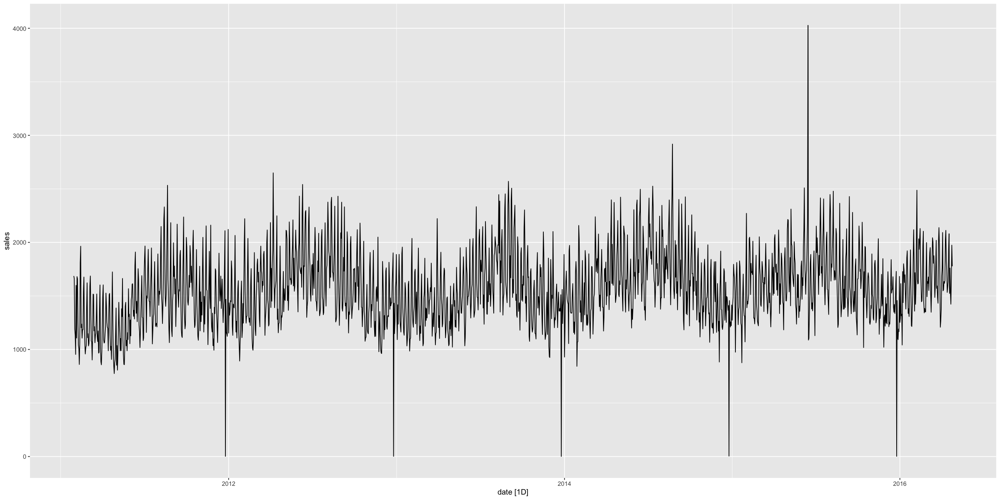

In [258]:
tsibble_sales_by_day = df_sales %>%
    group_by(date)  %>%
    summarise(sales = sum(sales), .groups="drop")  %>%
    as_tsibble(index=date)

tsibble_sales_by_day %>%
    autoplot(sales)

Food total sales time series demonstrates clear seasonality. We also observe some peaks at the end of every year due to the christmas event. We also notice that in the end of August of 2015, there is a peak due to the NBA final match. Some of the peaks could be explained by events effect.

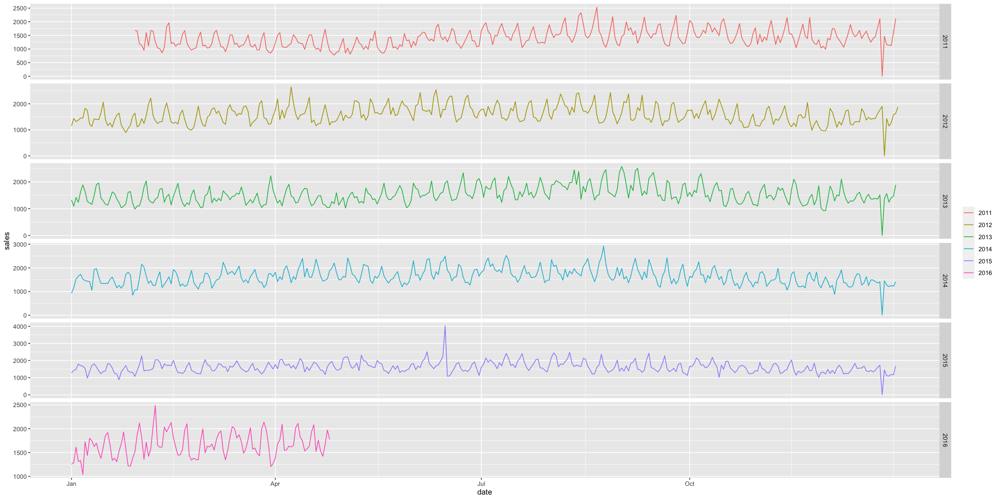

In [141]:
tsibble_sales_by_day_year = df_sales %>%
    group_by(year, date)  %>%
    summarise(sales = sum(sales), .groups="drop")  %>%
    as_tsibble(index=date)

tsibble_sales_by_day_year %>%
    gg_season(sales) +
    facet_grid(vars(year), scales = "free_y")

From the above graph, we could observe the similarity of the variations for each year's sales time series.

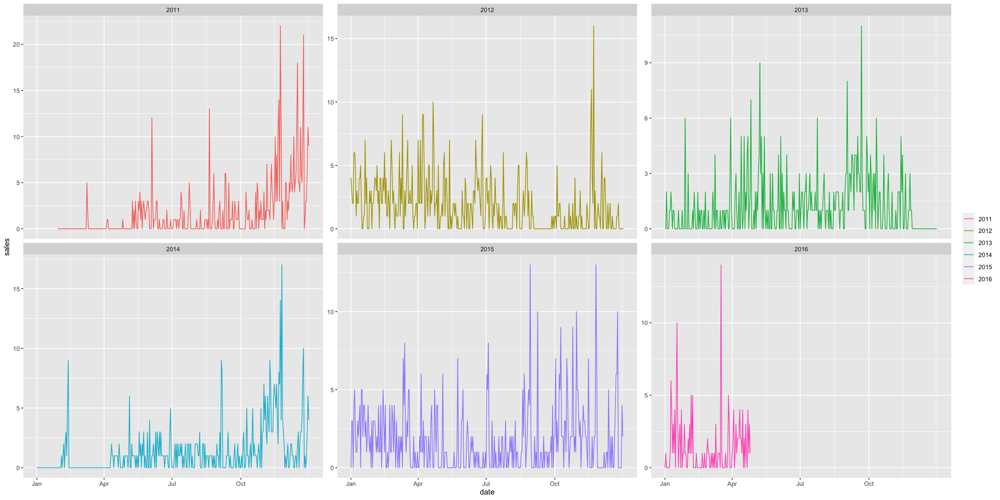

In [142]:
tsibble_sales_by_day_product = df_sales %>%
    as_tsibble(index=date, key=c("id"))

tsibble_sales %>%
    filter(id == "FOODS_3_015_TX_3_validation") %>%
    gg_season(sales) +
    facet_wrap(vars(year), scales = "free_y")

For each individual products, we observe greater uncertainties between years and individual product sales time series is rather different from each other.

### decomposition series

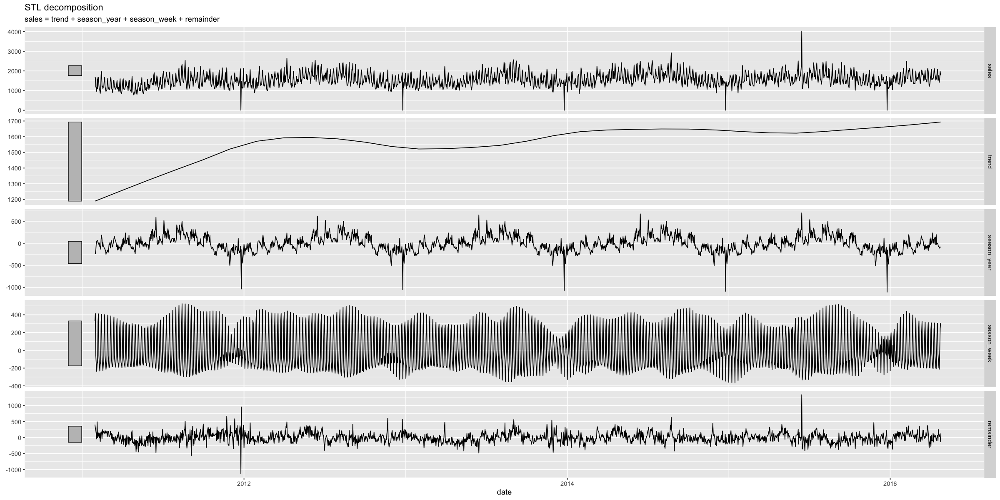

In [261]:
tsibble_sales_by_day_year %>%
  model(stl = STL(sales)) %>%
  components() %>%
  autoplot()

We observe strong seasonality but weak trend.

## Weekday sales plots

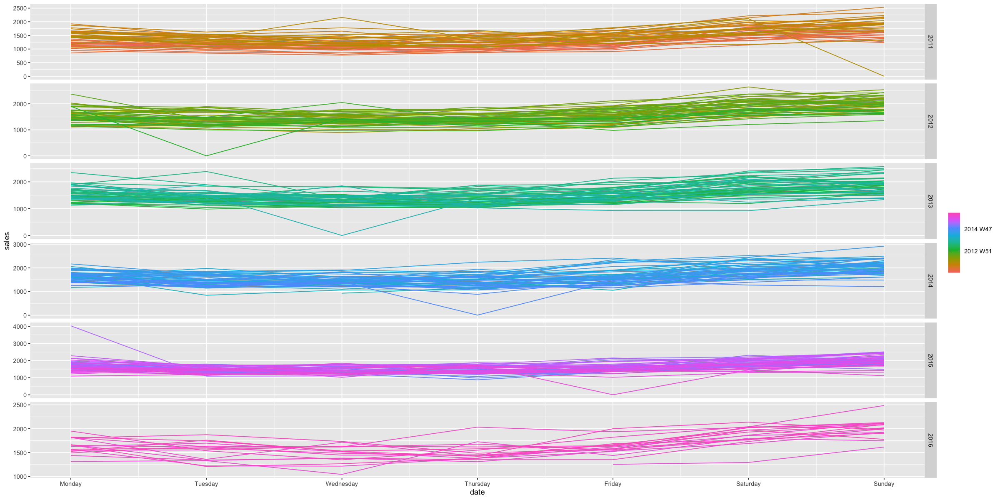

In [213]:
tsibble_sales_by_weekdays = df_sales %>%
    group_by(year, date) %>%
    summarize(sales = sum(sales), .groups="drop") %>%
    as_tsibble(index=date, key=("year"))
tsibble_sales_by_weekdays %>%
    gg_season(sales, period = "week")


Food total sales tends to have larger amount during weekends than weekdays.

year,wday,weekdays,sales
<dbl>,<dbl>,<chr>,<int>
2011,1,Sunday,35
2011,2,Monday,26
2011,3,Tuesday,59
2011,4,Wednesday,20
2011,5,Thursday,37
2011,6,Friday,26


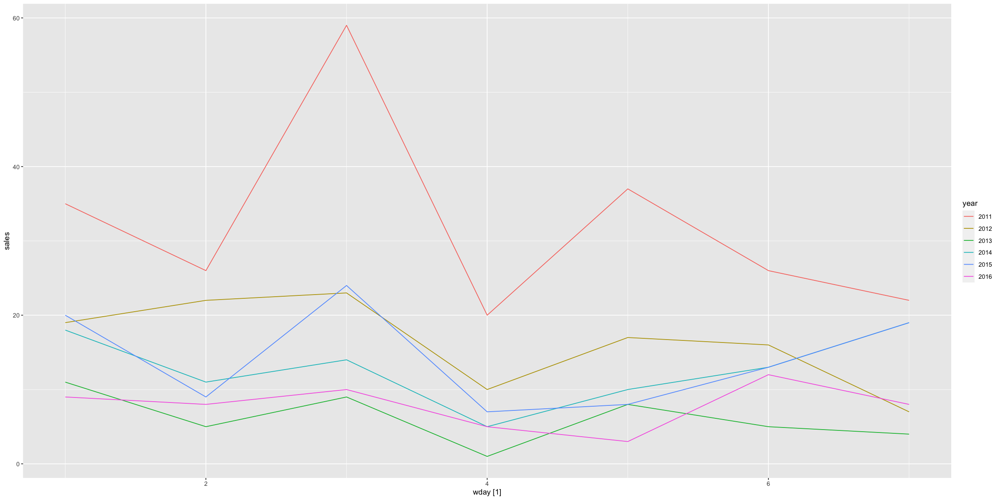

In [224]:
tsibble_sales_by_weekdays_product = df_sales  %>%
    mutate(wday = wday(date)) %>%
    filter(id == "FOODS_3_001_TX_3_validation") %>%
    group_by(year, wday, weekdays) %>%
    summarize(sales = sum(sales), .groups="drop") %>%
    as_tsibble(index=wday, key=("year"))
head(tsibble_sales_by_weekdays_product)
tsibble_sales_by_weekdays_product %>%
    autoplot(sales)

Individual product sales does not always have more sales during weekends. For example, 001 had most of the sales on Tuesday.

## Monthly sales subseries

### general view in boxplots

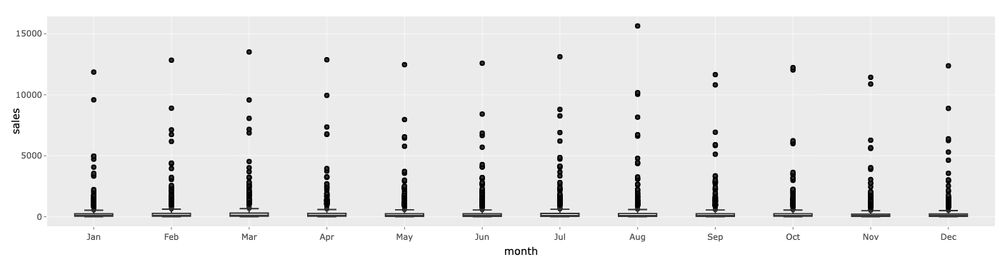

In [305]:
sales_by_month = df_sales %>%
    select(id, date, sales) %>%
    mutate(month = month(date, label=TRUE, abbr=TRUE)) %>%
    group_by(id, month) %>%
    summarize(sales = sum(sales), .groups="drop")

p <- ggplot(sales_by_month, aes(x=month, y=sales, fill=month, group = 1)) + 
     geom_boxplot(outlier.shape = NA)

ggplotly(p)

Monthly total sales of most products are around 100. Some products have much higher sales quantity comparing to other products. They could be common daily food such as bread. This feature could be used for clustering to distinguish common food from uncommon food.

### aggregated view

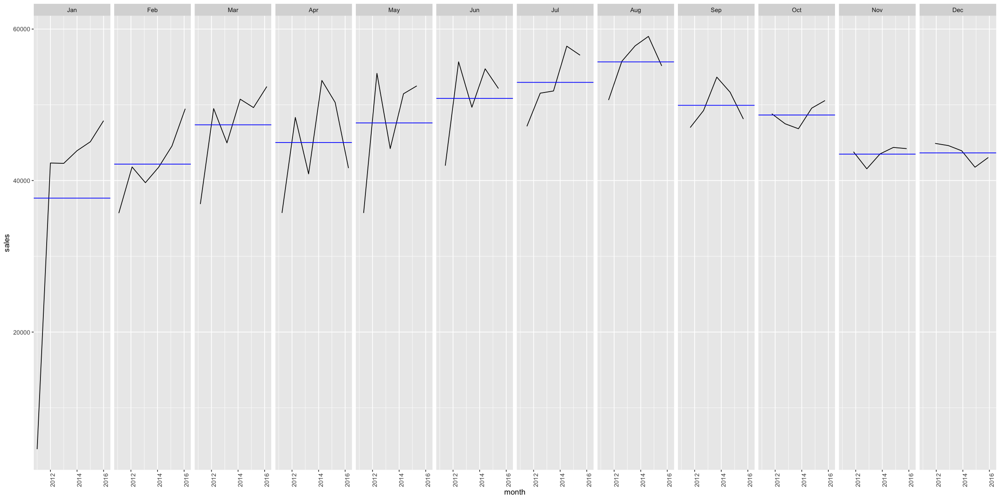

In [51]:
sales_by_month = df_sales %>%
    select(id, month, sales)  %>%
    group_by(month) %>%
    summarise(sales = sum(sales), .groups="drop")

tsibble_sales_by_month = sales_by_month %>%
    as_tsibble(index=month)

tsibble_sales_by_month %>%
    gg_subseries(sales)

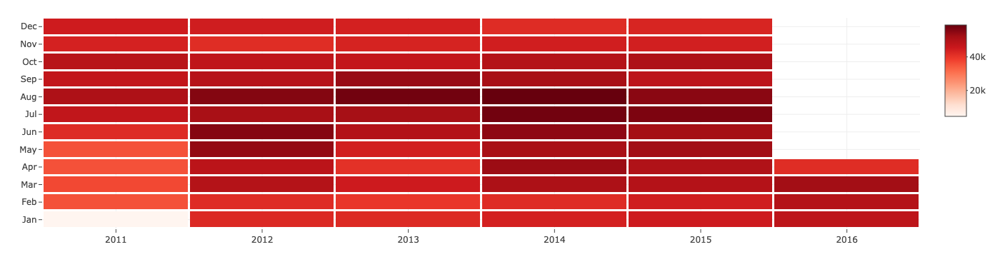

In [313]:
sales_by_month = df_sales %>%
    select(id, year, date, sales)  %>%
    mutate(month = month(date, label=TRUE, abbr=TRUE)) %>%
    group_by(year, month) %>%
    summarise(sales = sum(sales), .groups="drop")

plot_ly(x = sales_by_month$year,
        y = sales_by_month$month,
        z = sales_by_month$sales,
        colors = "Reds",
        xgap = 3,
        ygap = 3,
        type = "heatmap")

### individual view

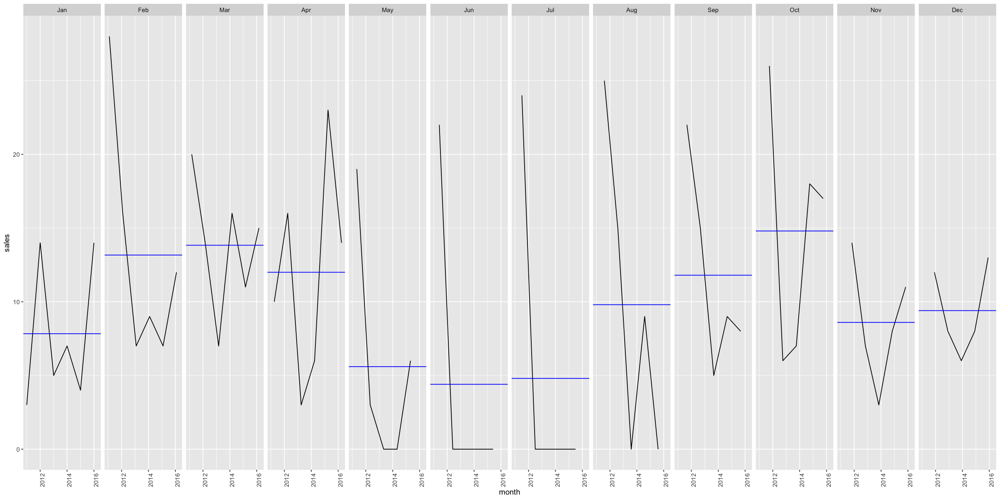

In [ ]:
sales_by_month_product = df_sales %>%
    select(id, month, sales)  %>%
    group_by(id, month) %>%
    summarise(sales = sum(sales), .groups="drop")

tsibble_sales_by_month = sales_by_month_product %>%
    as_tsibble(index=month, key=c(id))

tsibble_sales_by_month %>%
    filter(id == "FOODS_3_001_TX_3_validation")  %>%
    select(-id) %>%
    gg_subseries(sales)

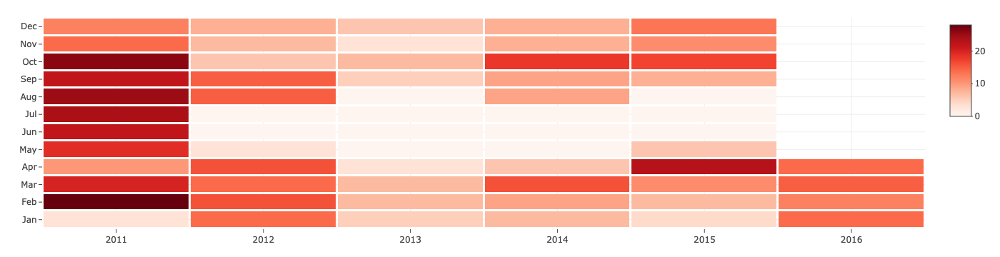

In [317]:
sales_by_month = df_sales %>%
    select(id, year, date, sales)  %>%
    filter(id == "FOODS_3_001_TX_3_validation")  %>%
    mutate(month = month(date, label=TRUE, abbr=TRUE)) %>%
    group_by(year, month) %>%
    summarise(sales = sum(sales), .groups="drop")

plot_ly(x = sales_by_month$year,
        y = sales_by_month$month,
        z = sales_by_month$sales,
        colors = "Reds",
        xgap = 3,
        ygap = 3,
        type = "heatmap")

Clearly, we see that sum of all products has different seasonality comparing to one particular product. Clustering might be helpful.

## Quarterly sales subseries

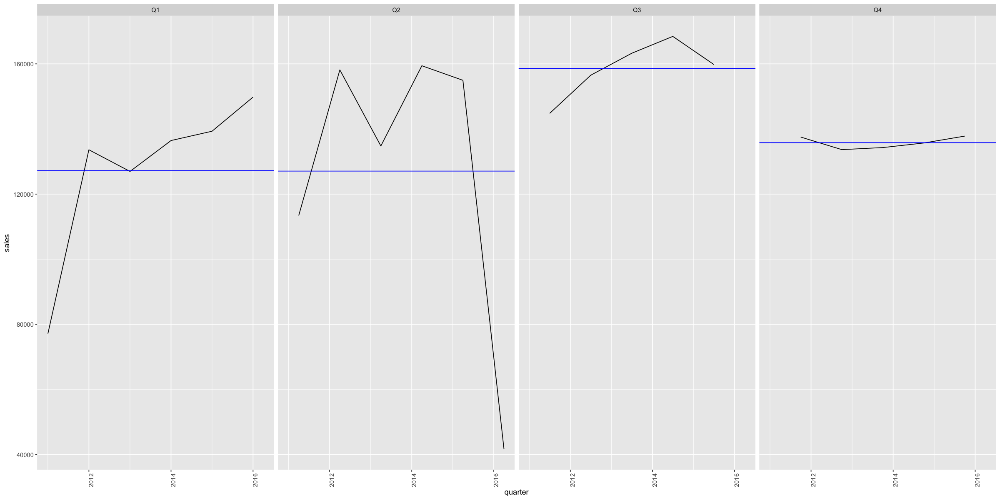

In [318]:
sales_by_quarter = df_sales %>%
    select(id, quarter, sales)  %>%
    group_by(quarter) %>%
    summarise(sales = sum(sales), .groups="drop")

tsibble_sales_by_quarter = sales_by_quarter %>%
    as_tsibble(index=quarter)

tsibble_sales_by_quarter %>%
    gg_subseries(sales)

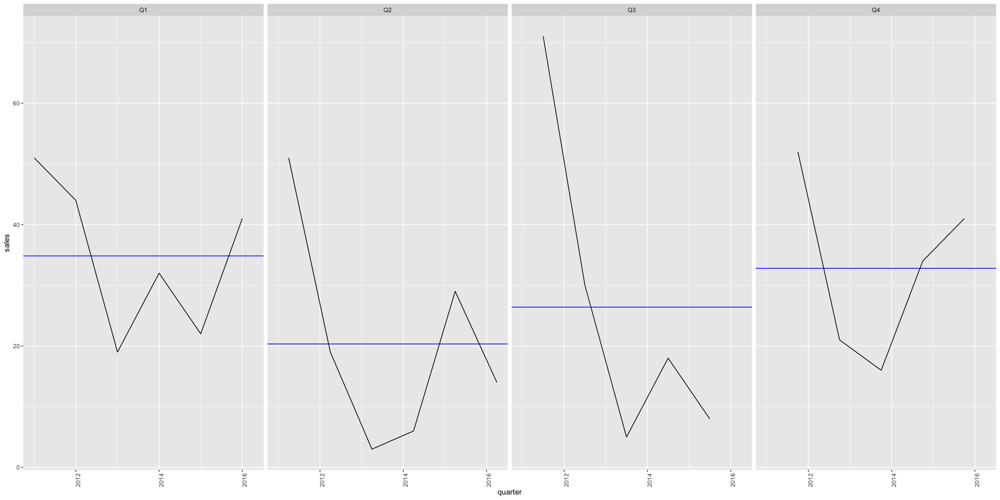

In [57]:
sales_by_quarter_product = df_sales %>%
    select(id, quarter, sales)  %>%
    group_by(id, quarter) %>%
    summarise(sales = sum(sales), .groups="drop")

tsibble_sales_by_quarter = sales_by_quarter_product %>%
    as_tsibble(index=quarter, key=c(id))

tsibble_sales_by_quarter %>%
    filter(id == "FOODS_3_001_TX_3_validation")  %>%
    select(-id) %>%
    gg_subseries(sales)

Clearly, we see that average of all all products has different seasonality comparing to one particular product. Clustering might be helpful.

## Weekly sales subseries

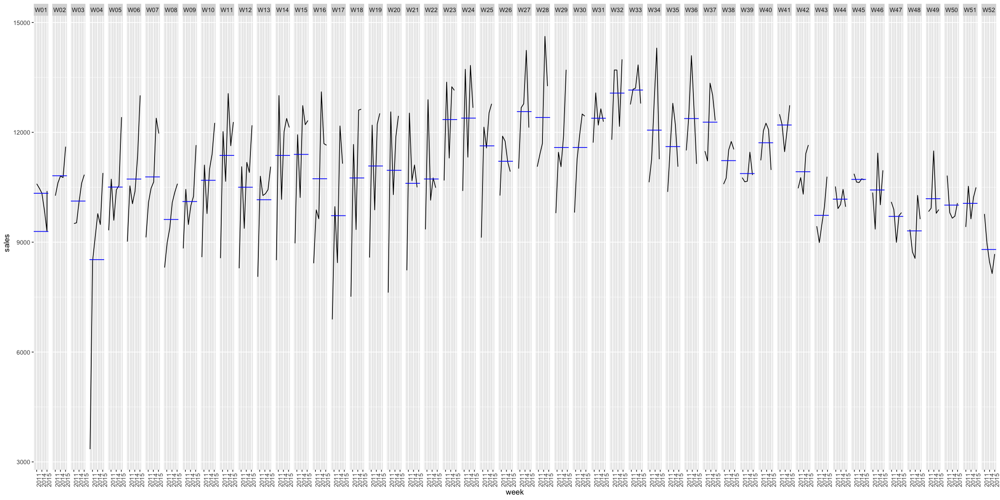

In [59]:
sales_by_week = df_sales %>%
    select(id, week, sales)  %>%
    group_by(week) %>%
    summarise(sales = sum(sales), .groups="drop")

tsibble_sales_by_week = sales_by_week %>%
    as_tsibble(index=week)

tsibble_sales_by_week %>%
    gg_subseries(sales)

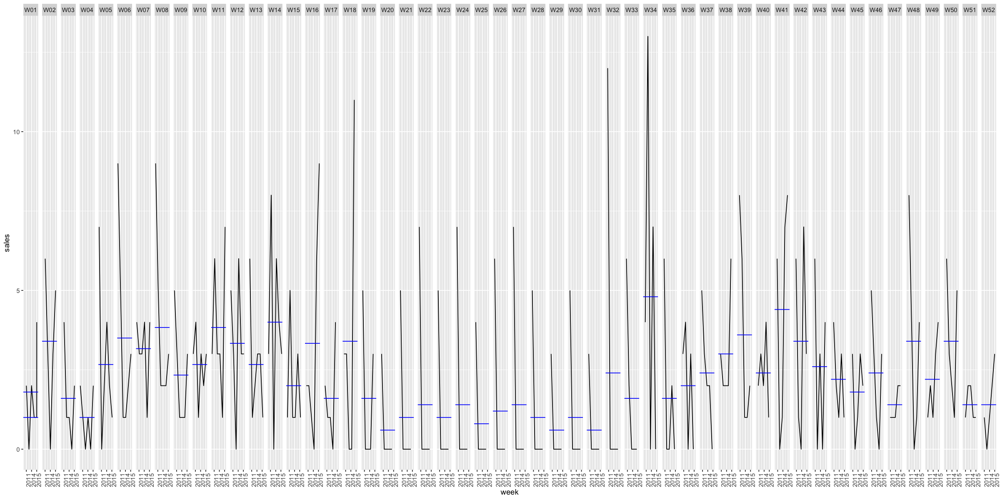

In [60]:
sales_by_week = df_sales %>%
    select(id, week, sales)  %>%
    group_by(id, week) %>%
    summarise(sales = sum(sales), .groups="drop")

tsibble_sales_by_week = sales_by_week %>%
    as_tsibble(index=week, key=c(id))

tsibble_sales_by_week %>%
    filter(id == "FOODS_3_001_TX_3_validation")  %>%
    select(-id) %>%
    gg_subseries(sales)

Clearly, we see that average of all all products has different seasonality comparing to one particular product. Clustering might be helpful.

## Yearly sales

In [ ]:
sales_by_year = df_sales %>%
    select(id, year, sales)  %>%
    group_by(id, year) %>%
    summarise(sales = sum(sales), .groups="drop")
head(sales_by_year)

In [61]:
sales_by_year = df_sales %>%
    select(id, year, sales)  %>%
    group_by(id, year) %>%
    summarise(sales = sum(sales), .groups="drop")
head(sales_by_year)

id,year,sales
<chr>,<dbl>,<int>
FOODS_3_001_TX_3_validation,2011,225
FOODS_3_001_TX_3_validation,2012,114
FOODS_3_001_TX_3_validation,2013,43
FOODS_3_001_TX_3_validation,2014,90
FOODS_3_001_TX_3_validation,2015,100
FOODS_3_001_TX_3_validation,2016,55


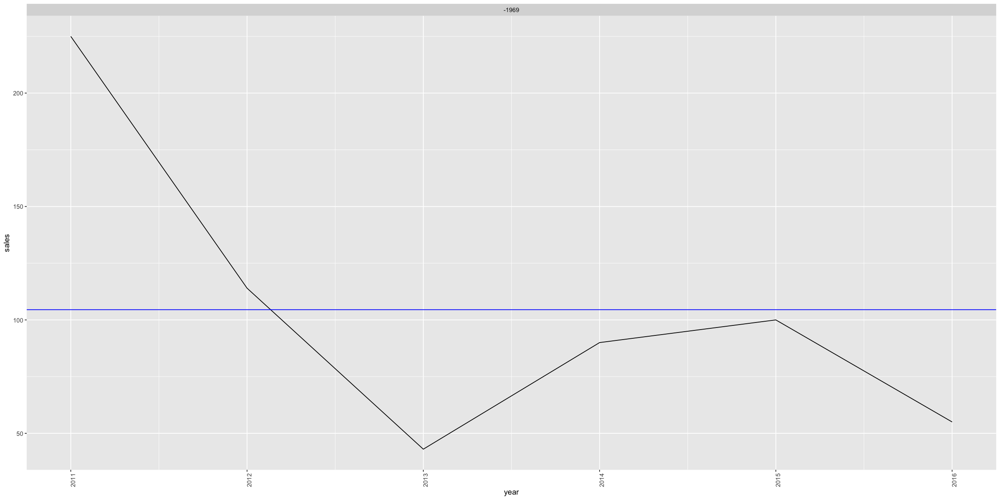

In [34]:
tsibble_sales_by_year = sales_by_year %>%
    as_tsibble(index=year, key=c(id))

tsibble_sales_by_year %>%
    filter(id == "FOODS_3_001_TX_3_validation")  %>%
    select(-id) %>%
    gg_subseries(sales)

## Sales Price Correlation

In [339]:
head(df_sales_cal_price)

,item_validation_id,wm_yr_wk,date,id,sales,weekday,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,snap_TX,store_id,item_id,sell_price,day_of_month
,<chr>,<int>,<date>,<chr>,<int>,<chr>,<int>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<dbl>,<dbl>
1,FOODS_3_001_TX_3_validation,11101,2011-02-02,FOODS_3_001_TX_3_validation,0,Wednesday,5,2,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,2
2,FOODS_3_001_TX_3_validation,11101,2011-02-03,FOODS_3_001_TX_3_validation,0,Thursday,6,2,2011,NA,NA,NA,NA,1,TX_3,FOODS_3_001,2.28,3
3,FOODS_3_001_TX_3_validation,11101,2011-01-30,FOODS_3_001_TX_3_validation,2,Sunday,2,1,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,30
4,FOODS_3_001_TX_3_validation,11101,2011-02-01,FOODS_3_001_TX_3_validation,3,Tuesday,4,2,2011,NA,NA,NA,NA,1,TX_3,FOODS_3_001,2.28,1
5,FOODS_3_001_TX_3_validation,11101,2011-01-31,FOODS_3_001_TX_3_validation,1,Monday,3,1,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,31
6,FOODS_3_001_TX_3_validation,11101,2011-02-04,FOODS_3_001_TX_3_validation,1,Friday,7,2,2011,NA,NA,NA,NA,0,TX_3,FOODS_3_001,2.28,4


Warning message:
“Removed 96 rows containing non-finite values (stat_smooth).”


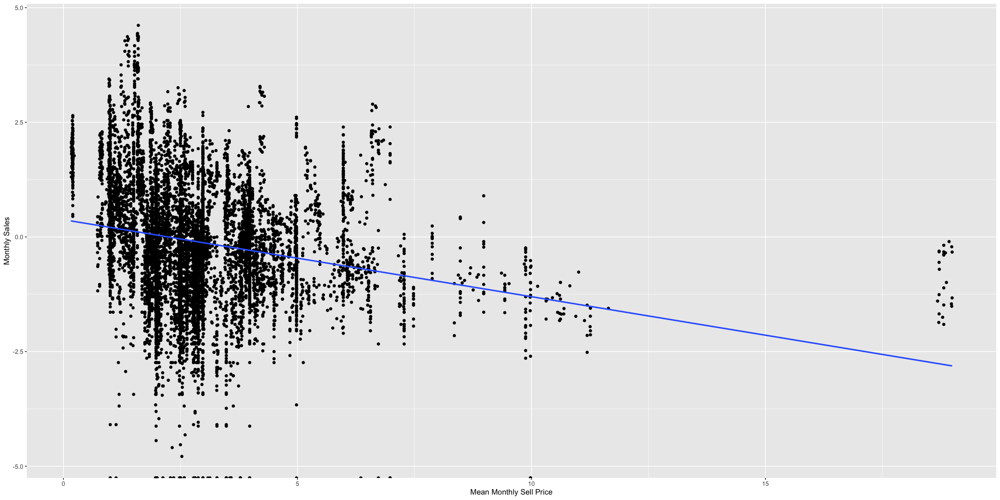

In [371]:
df_sales_price_corr = df_sales_cal_price %>%
    select(item_validation_id, date, sales, sell_price) %>%
    mutate(month = month(date, label=TRUE, abbr=TRUE)) %>%
    mutate(month = month(date, label=TRUE, abbr=TRUE)) %>%
    group_by(item_validation_id, month) %>%
    summarize(sales = mean(sales),  sell_price = mean(sell_price), .groups="drop")

df_sales_price_corr %>%
  ggplot(aes(x = sell_price, y = log(sales))) +
  labs(y = "Monthly Sales",
       x = "Mean Monthly Sell Price") +
  geom_point() +
  geom_smooth(method = "lm", formula = y ~ x, se = FALSE)

log-linear transformion is useful in the modelling a nonlinear relationship between monthly sales and sell price. Nevertheless a big amount of sales errors cannot be explained by the this linear model. Clustering of products may be helpful to distinguish products of different nature so that sales quantity could be much better explained.

## Event Analysis

### Prepare data

In [331]:
events_dates = df_sales_cal_price  %>%
    filter(!is.na(event_name_1) | !is.na(event_name_2))  %>%
    select(date, event_name_1, event_type_1) %>%
    unique()
head(events_dates)

,date,event_name_1,event_type_1
,<date>,<chr>,<chr>
1,2011-02-06,SuperBowl,Sporting
2,2011-02-14,ValentinesDay,Cultural
3,2011-02-21,PresidentsDay,National
4,2011-03-09,LentStart,Religious
5,2011-03-16,LentWeek2,Religious
6,2011-03-17,StPatricksDay,Cultural


### Sales by Event Name 1 and 2

In [319]:
df_sales_cal_price %>%
    group_by(event_name_1) %>%
    summarise(mean_sales = mean(sales), n = n(), sd_sales = sd(sales), .groups="drop") %>% head()

event_name_1,mean_sales,n,sd_sales
<chr>,<dbl>,<int>,<dbl>
Chanukah End,2.165820137,3347,7.47130334
Christmas,0.003277712,3356,0.06216162
Cinco De Mayo,2.525625745,2517,6.55269690
ColumbusDay,2.646739130,3312,7.28250915
Easter,2.699120068,3523,7.72737979
Eid al-Fitr,2.677060821,3239,8.27974089


In [333]:
df_sales_cal_price %>%
    group_by(event_name_2) %>%
    summarise(mean_sales = mean(sales), n = n(), std_sales = sd(sales), .groups="drop")

event_name_2,mean_sales,n,std_sales
<chr>,<dbl>,<int>,<dbl>
Cinco De Mayo,2.573248,628,6.908104
Easter,3.078049,410,10.448793
Father's day,3.258486,766,9.318393
OrthodoxEaster,2.671979,753,7.132296
NA,2.403477,1244060,7.048845


### Sales Timeseries with events 

Warning message:
“Removed 2 rows containing missing values (geom_vline).”
Warning message:
“Removed 2 rows containing missing values (geom_text).”


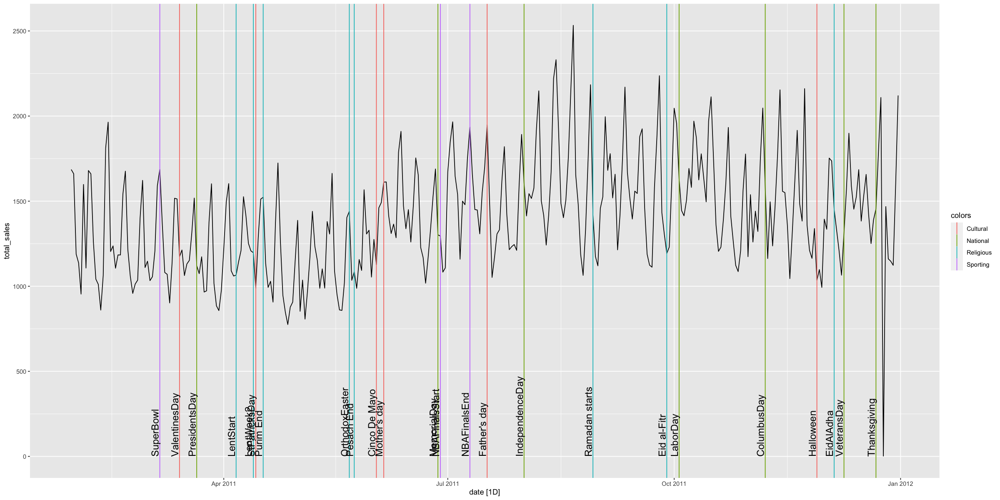

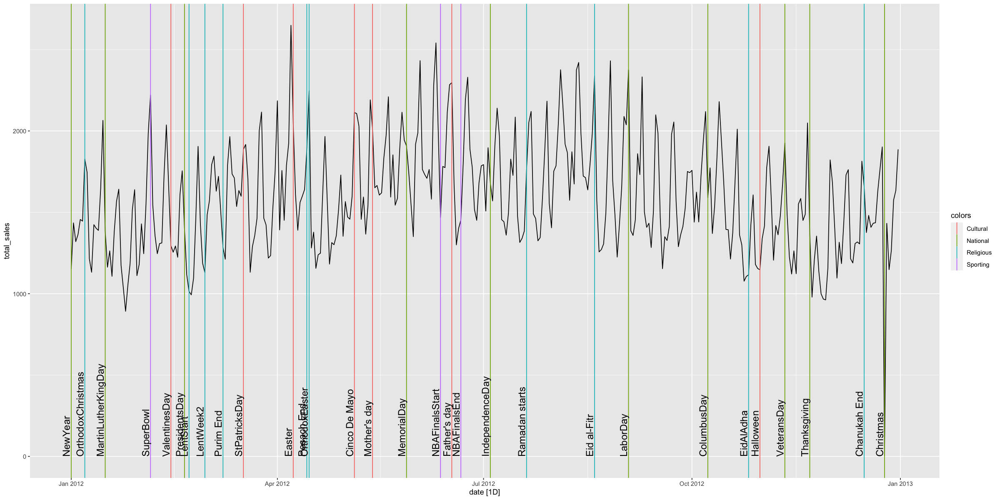

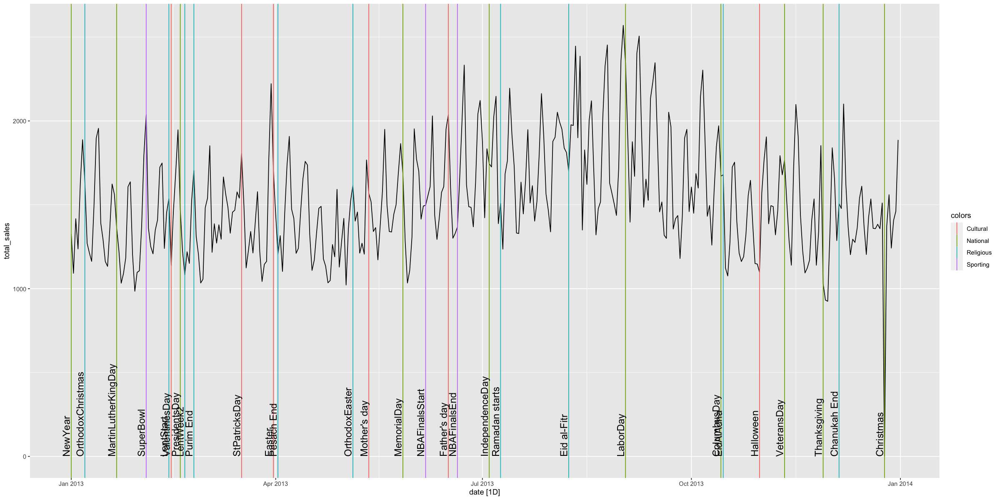

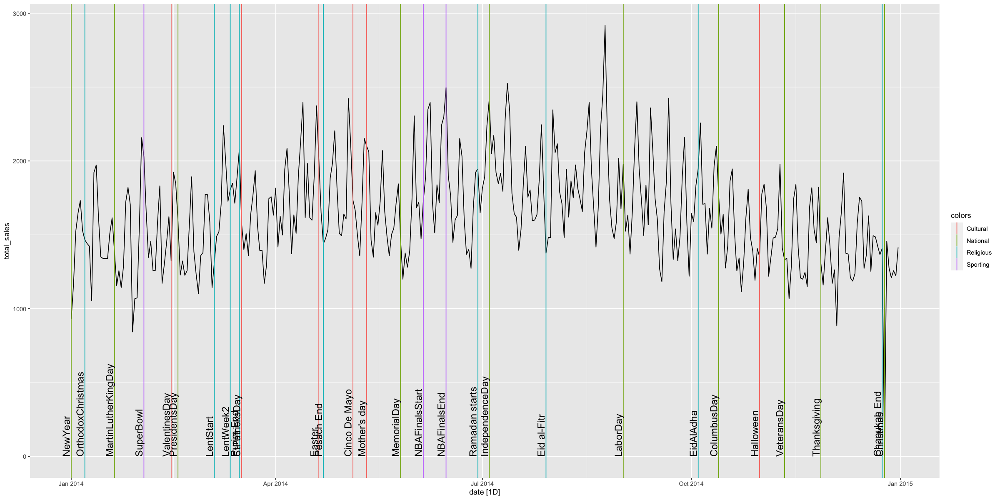

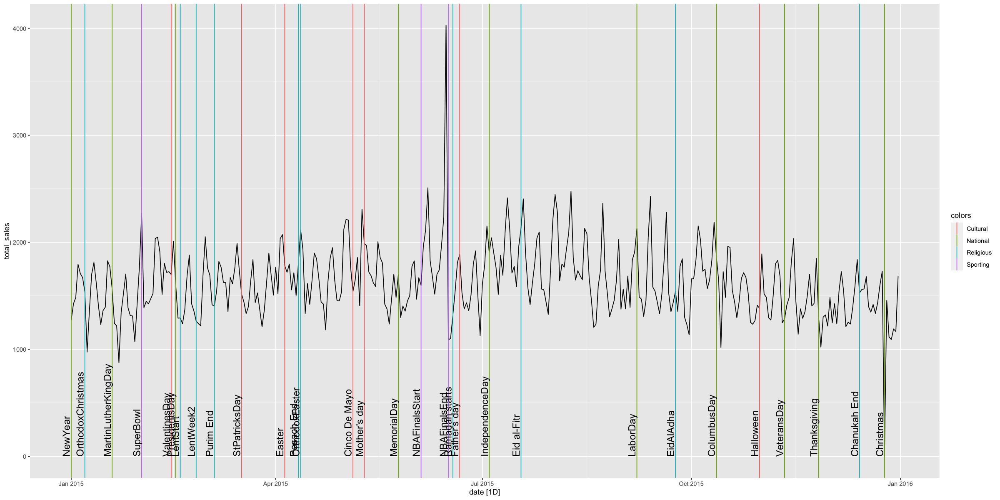

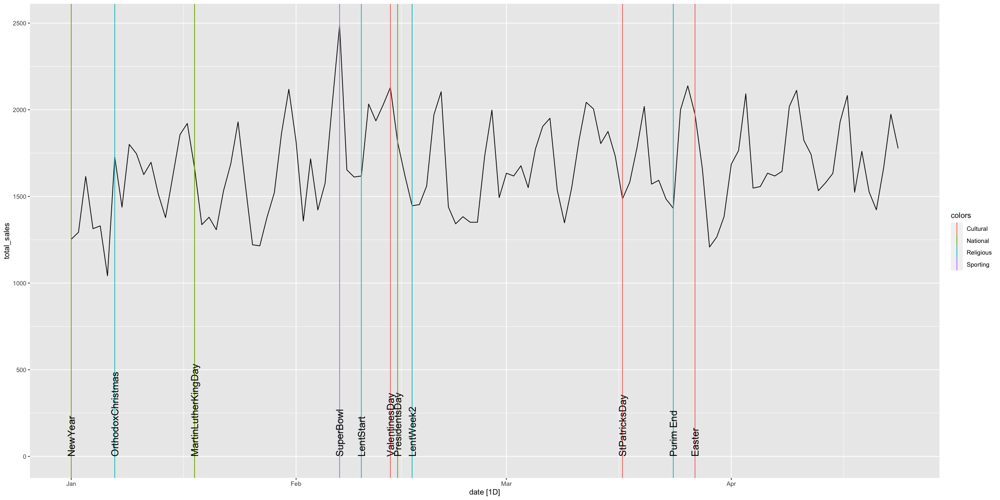

In [106]:
draw_sales_by_year = function(arg_year) {
    
    diff_days <- function(date) { # create a function with the name my_function
      as.numeric(difftime(date, as.Date(paste("01/01/",arg_year), "%m/%d/%Y") , units = "days"))
    }
    
    events_dates_by_year = events_dates %>%
                        filter(year(date)==arg_year)
    events_dates_index_by_year = unlist(lapply(events_dates_by_year$date, diff_days))
    
    tsibble_sales_by_year = df_sales_cal_price %>% 
        filter(year==arg_year) %>% 
        #filter(item_validation_id=="FOODS_3_014_TX_3_validation") %>% 
        group_by(date) %>% 
        summarize(total_sales = sum(sales))  %>% 
        as_tsibble(index=date)
    
    events_info <- data.frame(label = events_dates_by_year$event_name_1,
                              colors = events_dates_by_year$event_type_1,
                              vals = tsibble_sales_by_year$date[events_dates_index_by_year+1])
    tsibble_sales_by_year %>%
        autoplot(total_sales) +
        geom_vline(mapping = aes(xintercept = vals, color = colors), data=events_info) +
        geom_text(mapping = aes(x = vals + 1, y = 0, label = label, angle=90, hjust = 0, vjust = -0.5), size=5, data=events_info)
}

draw_sales_by_year(2011)
draw_sales_by_year(2012)
draw_sales_by_year(2013)
draw_sales_by_year(2014)
draw_sales_by_year(2015)
draw_sales_by_year(2016)

It is doubtless that the events plays an important role in explaining some peaks in sales quantity. Important events such as Easter, Christmas, NBA finals and superbowl contribute greatly to the temporary peaks. Sports events tends to have shorter influential period than festivals such as Easter, Christmas where people tend to buy things much earlier.

### Sales by Events Types 1 and 2

In [324]:
df_sales_cal_price %>%
    group_by(event_type_1) %>%
    summarise(mean_sales = mean(sales), n = n(), std_sales = sd(sales), .groups="drop")

event_type_1,mean_sales,n,std_sales
<chr>,<dbl>,<int>,<dbl>
Cultural,2.516226,22649,7.367720
National,2.186121,33575,6.966608
Religious,2.371566,33566,6.860500
Sporting,2.793205,10155,8.162194
NA,2.406179,1146672,7.042677


In [325]:
df_sales_cal_price %>%
    group_by(event_type_2) %>%
    summarise(mean_sales = mean(sales), n = n(), std_sales = sd(sales), .groups="drop")

event_type_2,mean_sales,n,std_sales
<chr>,<dbl>,<int>,<dbl>
Cultural,2.978936,1804,8.848550
Religious,2.671979,753,7.132296
NA,2.403477,1244060,7.048845


### Christmas Effect

Plot variable not specified, automatically selected `.vars = sales`


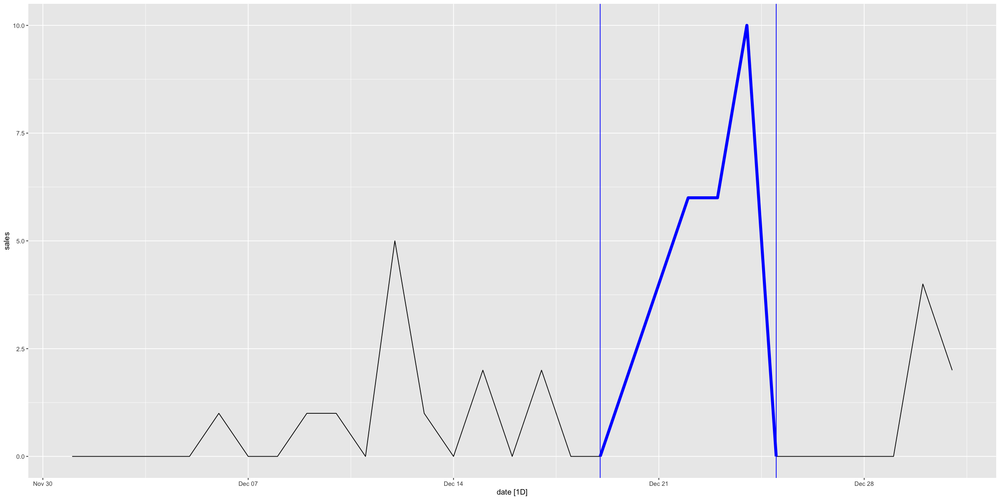

In [90]:
tsibble_sales_christmas = tsibble_sales %>%
    filter(id == "FOODS_3_015_TX_3_validation") %>%
    filter(year == 2015)  %>%
    filter(month(date) == 12)

tsibble_sales_christmas %>%
    autoplot(sales) +
    autolayer(
        filter_index(tsibble_sales_christmas, "2015-12-19" ~ "2015-12-25"),
        colour = "blue",
        size = 2,
    ) + 
    geom_vline(xintercept = tsibble_sales_christmas$date[c(19, 25)], color = "blue")

### Easter Effect

In [67]:
df_sales_cal_price %>%
    filter(event_name_1 == "Easter") %>%
    filter(year == 2015) %>% head()

,item_validation_id,wm_yr_wk,date,id,sales,weekday,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,snap_TX,store_id,item_id,sell_price,day_of_month
,<chr>,<int>,<date>,<chr>,<int>,<chr>,<int>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<dbl>,<dbl>
1,FOODS_3_001_TX_3_validation,11510,2015-04-05,FOODS_3_001_TX_3_validation,0,Sunday,2,4,2015,Easter,Cultural,NA,NA,1,TX_3,FOODS_3_001,2.50,5
2,FOODS_3_002_TX_3_validation,11510,2015-04-05,FOODS_3_002_TX_3_validation,4,Sunday,2,4,2015,Easter,Cultural,NA,NA,1,TX_3,FOODS_3_002,2.50,5
3,FOODS_3_003_TX_3_validation,11510,2015-04-05,FOODS_3_003_TX_3_validation,0,Sunday,2,4,2015,Easter,Cultural,NA,NA,1,TX_3,FOODS_3_003,3.98,5
4,FOODS_3_004_TX_3_validation,11510,2015-04-05,FOODS_3_004_TX_3_validation,0,Sunday,2,4,2015,Easter,Cultural,NA,NA,1,TX_3,FOODS_3_004,5.98,5
5,FOODS_3_005_TX_3_validation,11510,2015-04-05,FOODS_3_005_TX_3_validation,0,Sunday,2,4,2015,Easter,Cultural,NA,NA,1,TX_3,FOODS_3_005,2.28,5
6,FOODS_3_006_TX_3_validation,11510,2015-04-05,FOODS_3_006_TX_3_validation,1,Sunday,2,4,2015,Easter,Cultural,NA,NA,1,TX_3,FOODS_3_006,7.88,5


Plot variable not specified, automatically selected `.vars = sales`


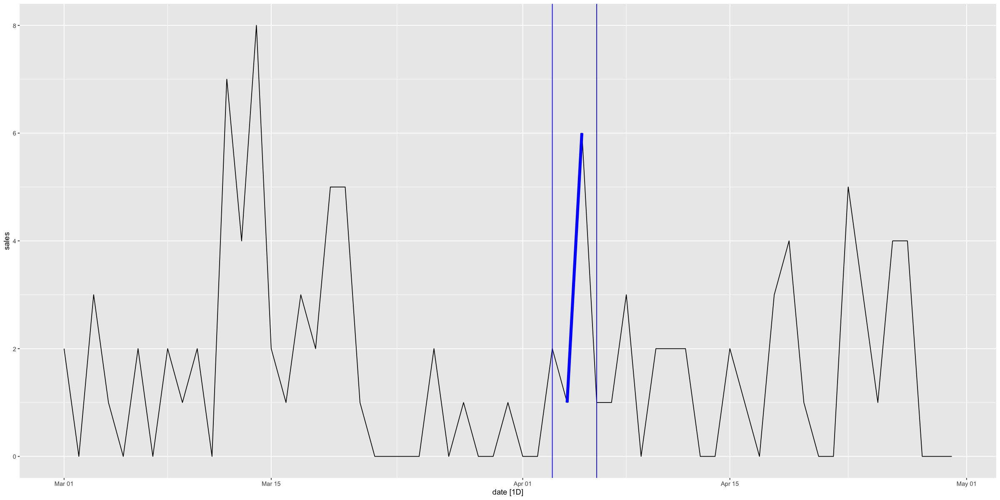

In [98]:
tsibble_sales_easter = tsibble_sales %>%
    filter(id == "FOODS_3_015_TX_3_validation") %>%
    filter(year == 2015)  %>%
    filter(month(date) %in% c(3,4))

tsibble_sales_easter %>%
    autoplot(sales) +     
    autolayer(
        filter_index(tsibble_sales_easter, "2015-04-04" ~ "2015-04-05"),
        colour = "blue",
        size = 2,
    ) + 
    geom_vline(xintercept = tsibble_sales_easter$date[c(34, 37)], color = "blue")